In [2]:
import os

import wrds

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from reportlab.pdfgen import canvas
from reportlab.lib.pagesizes import letter

c:\Users\YeonChan Kang\anaconda3\envs\fdb\lib\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


In [84]:
from tabulate import tabulate

In [58]:
from scipy.stats import skew, kurtosis, pearsonr, spearmanr, rankdata

In [3]:
db = wrds.Connection()

WRDS recommends setting up a .pgpass file.
Created .pgpass file successfully.
You can create this file yourself at any time with the create_pgpass_file() function.
Loading library list...
Done


In [4]:
db.list_tables(library='contrib_global_factor')

['global_factor']

In [5]:
db.describe_table(library='contrib_global_factor', table='global_factor')['name']

Approximately 25331184 rows in contrib_global_factor.global_factor.


0          permno
1          permco
2           gvkey
3             iid
4              id
          ...    
438           age
439           qmj
440      qmj_prof
441    qmj_growth
442    qmj_safety
Name: name, Length: 443, dtype: object

In [6]:
USA = db.raw_sql("""
                 SELECT *
                 FROM contrib_global_factor.global_factor
                 WHERE excntry = 'USA'
                 AND obs_main = 1
                 AND common = 1
                 AND primary_sec = 1
                 AND exch_main = 1
                 ORDER BY date, gvkey
                """)

c:\Users\YeonChan Kang\anaconda3\envs\fdb\lib\site-packages\wrds\sql.py:580: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  full_df = pd.concat([full_df, chunk])


In [8]:
USA.to_csv('C:/Users/YeonChan Kang/Desktop/Local_repo/Factor-Momentum-Reversal-and-Turning-Point/USA.csv')

In [6]:
# Restrict to main observations
#USA[USA['obs_main']==1]

# Restrict to common stock
#USA[USA['common']==1]

# Restrict to prominent exchanges
#USA[USA['exch_main']==1]

# Restrict to primary listing x month
#USA[USA['pricmary_sec']==1]

In [7]:
# Basic - 39
# must: id, eom
#  Except from Basic: gvkey, permno, permco, gvkey, iid, date, excntry, curcd, exch_main, primary_sec, fx, common, comp_tpci, comp_shrcd, comp_exchg, adjft, naics, gics, ff49
#  date, 'source_crsp, size_grp, crsp_exchcd, ret_local, prc_local
# 'sic', 'shares', 'dolvol', 'tvol', 'bidask', 'prc', 'prc_high', 'prc_low', 'ret_lag_dif', 'me', 'ret', 'me_company'
# Main - 153
# Secondary - 251

In [9]:
size_classification = USA[['id', 'eom','size_grp']]

In [10]:
ind_classification = USA[['id', 'eom','sic']]

In [11]:
information = USA[['id', 'eom', 'shares', 'dolvol', 'tvol', 'bidask', 'prc', 'prc_high', 'prc_low', 'ret_lag_dif', 'me', 'ret', 'me_company']]

In [12]:
identifiers = ['date', 'eom']

In [13]:
USA.drop(columns=['gvkey', 'permno', 'permco', 'iid', 'excntry','curcd', 'exch_main', 'primary_sec', 'fx', 'common', 'comp_tpci', 'crsp_shrcd', 'comp_exchg', 'adjfct', 'naics', 'gics', 'ff49'], inplace=True)

In [14]:
USA.drop(columns=['sic', 'shares', 'dolvol', 'tvol', 'bidask', 'prc_high', 'prc_low', 'ret_lag_dif', 'me', 'ret', 'me_company'], inplace=True)

In [15]:
USA.drop(columns=['date', 'source_crsp','size_grp', 'obs_main', 'crsp_exchcd', 'prc_local', 'ret_local'], inplace=True)

In [16]:
len(USA.columns)

408

In [17]:
USA

,id,eom,prc,ret_exc,ret_exc_lead1m,market_equity,enterprise_value,book_equity,assets,sales,...,bidaskhl_21d,rvolhl_21d,corr_1260d,betabab_1260d,rmax5_rvol_21d,age,qmj,qmj_prof,qmj_growth,qmj_safety
0,14672.0,1925-12-31,3.00,NaN,0.142882,3.36300,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
1,14453.0,1925-12-31,79.75,NaN,0.031532,10.36750,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
2,11455.0,1925-12-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
3,10073.0,1925-12-31,17.50,NaN,0.047049,2.41500,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
4,15755.0,1925-12-31,68.25,NaN,-0.037750,20.47500,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211601,134970501.0,2024-03-31,7.91,NaN,NaN,347.24900,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,483.0,NaN,NaN,NaN,NaN
211602,134997201.0,2024-03-31,2.36,NaN,NaN,19.82636,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,51.0,NaN,NaN,NaN,NaN
211603,134999401.0,2024-03-31,1.49,NaN,NaN,4.72330,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,63.0,NaN,NaN,NaN,NaN
211604,135226201.0,2024-03-31,11.47,NaN,NaN,615.80136,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,483.0,NaN,NaN,NaN,NaN


# Preprocessing

### Winsorize

In [34]:
def winsorize(data, column=False, lower=0.01, upper=0.99, copy=True):
    """
    Winsorizes the input data by replacing extreme values with the nearest values within the specified quantiles.
    
    Parameters:
    data (pd.Series or pd.DataFrame): The data to be winsorized.
    column (str or bool): The column to be winsorized or False to winsorize all columns. Defaults to False.
    lower (float): The lower quantile threshold. Defaults to 0.01.
    upper (float): The upper quantile threshold. Defaults to 0.99.
    copy (bool): Whether to return a copy of the data or to modify it in place. Defaults to True.
    
    Returns:
        pd.Series or pd.DataFrame: The winsorized data.
    """
    if copy:
        data = data.copy()
    
    if column:
        col_data = data[column]
        
        print(f"Original maximum of {column}: {col_data.max()} and Original minimum of {column}: {col_data.min()}\n")
        
        qtl = col_data.quantile([lower, upper])
        
        # Replace values below the lower quantile
        col_data[col_data < qtl.loc[lower]] = qtl.loc[lower]
        
        # Replace values above the upper quantile
        col_data[col_data > qtl.loc[upper]] = qtl.loc[upper]
        
        data[column] = col_data
        
        print(f"New maximum of {column}: {col_data.max()} and New minimum of {column}: {col_data.min()}\n")
    else:
        for col in data.columns:
            col_data = data[col]
            
            print(f"Original maximum of {col}: {col_data.max()} and Original minimum of {col}: {col_data.min()}\n")
            
            qtl = col_data.quantile([lower, upper])
            
            # Replace values below the lower quantile
            col_data[col_data < qtl.loc[lower]] = qtl.loc[lower]
            
            # Replace values above the upper quantile
            col_data[col_data > qtl.loc[upper]] = qtl.loc[upper]
            
            data[col] = col_data
            
            print(f"New maximum of {col}: {col_data.max()} and New minimum of {col}: {col_data.min()}\n")
    
    return data

In [36]:
n_USA = winsorize(USA, column='ret_exc_lead1m')

Original maximum of ret_exc_lead1m: 15348.999304 and Original minimum of ret_exc_lead1m: -1.014149

New maximum of ret_exc_lead1m: 0.5779431277148808 and New minimum of ret_exc_lead1m: -0.4036275816378783



C:\Users\YeonChan Kang\AppData\Local\Temp\ipykernel_282216\858738449.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  col_data[col_data < qtl.loc[lower]] = qtl.loc[lower]
C:\Users\YeonChan Kang\AppData\Local\Temp\ipykernel_282216\858738449.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  col_data[col_data > qtl.loc[upper]] = qtl.loc[upper]


In [37]:
n_USA = winsorize(n_USA, column='ret_exc')

Original maximum of ret_exc: 15348.999304 and Original minimum of ret_exc: -1.014149

New maximum of ret_exc: 0.5778867423901368 and New minimum of ret_exc: -0.39584499837711334



C:\Users\YeonChan Kang\AppData\Local\Temp\ipykernel_282216\858738449.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  col_data[col_data < qtl.loc[lower]] = qtl.loc[lower]
C:\Users\YeonChan Kang\AppData\Local\Temp\ipykernel_282216\858738449.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  col_data[col_data > qtl.loc[upper]] = qtl.loc[upper]


In [38]:
n_USA

,id,eom,prc,ret_exc,ret_exc_lead1m,market_equity,enterprise_value,book_equity,assets,sales,...,bidaskhl_21d,rvolhl_21d,corr_1260d,betabab_1260d,rmax5_rvol_21d,age,qmj,qmj_prof,qmj_growth,qmj_safety
0,14672.0,1925-12-31,3.00,NaN,0.142882,3.36300,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
1,14453.0,1925-12-31,79.75,NaN,0.031532,10.36750,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
2,11455.0,1925-12-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
3,10073.0,1925-12-31,17.50,NaN,0.047049,2.41500,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
4,15755.0,1925-12-31,68.25,NaN,-0.037750,20.47500,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211601,134970501.0,2024-03-31,7.91,NaN,NaN,347.24900,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,483.0,NaN,NaN,NaN,NaN
211602,134997201.0,2024-03-31,2.36,NaN,NaN,19.82636,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,51.0,NaN,NaN,NaN,NaN
211603,134999401.0,2024-03-31,1.49,NaN,NaN,4.72330,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,63.0,NaN,NaN,NaN,NaN
211604,135226201.0,2024-03-31,11.47,NaN,NaN,615.80136,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,483.0,NaN,NaN,NaN,NaN


### Penny Stock

In [39]:
# before, after 비교하는 문장 print 추가

def remove_penny_stocks(data, price_column, action='remove'):
    """
    Removes or replaces with NaN the rows where the stock price is less than 5 dollars.
    
    Parameters:
    data (pd.DataFrame): The input DataFrame.
    price_column (str): The column name that contains the stock prices.
    action (str): The action to take on penny stocks ('remove' or 'nan'). Defaults to 'remove'.
    
    Returns:
        pd.DataFrame: The DataFrame with penny stocks removed or replaced with NaN.
    """
    if action not in ['remove', 'nan']:
        raise ValueError("Action must be either 'remove' or 'nan'")
    
    if action == 'remove':
        # Remove rows where the stock price is less than 5 dollars
        data = data[data[price_column] >= 5]
    elif action == 'nan':
        # Replace stock prices less than 5 dollars with NaN
        data.loc[data[price_column] < 5, :] = np.nan
    
    return data

In [40]:
n_USA = remove_penny_stocks(n_USA, 'prc')

In [41]:
n_USA

,id,eom,prc,ret_exc,ret_exc_lead1m,market_equity,enterprise_value,book_equity,assets,sales,...,bidaskhl_21d,rvolhl_21d,corr_1260d,betabab_1260d,rmax5_rvol_21d,age,qmj,qmj_prof,qmj_growth,qmj_safety
1,14453.0,1925-12-31,79.75,NaN,0.031532,10.36750,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
3,10073.0,1925-12-31,17.50,NaN,0.047049,2.41500,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
4,15755.0,1925-12-31,68.25,NaN,-0.037750,20.47500,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
5,12669.0,1925-12-31,40.00,NaN,0.147049,4.64000,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
6,10268.0,1925-12-31,134.00,NaN,-0.021608,12.59600,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211596,134700701.0,2024-03-31,5.07,NaN,NaN,3385.26435,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,63.0,NaN,NaN,NaN,NaN
211597,134708501.0,2024-03-31,25.00,NaN,NaN,773.77500,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,483.0,NaN,NaN,NaN,NaN
211598,134861501.0,2024-03-31,28.00,NaN,NaN,944.74800,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,75.0,NaN,NaN,NaN,NaN
211601,134970501.0,2024-03-31,7.91,NaN,NaN,347.24900,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,483.0,NaN,NaN,NaN,NaN


In [44]:
# Cut the data from date: 1957-01-01 to 2023-12-31

sdate = pd.to_datetime('1957-01-01').date()
edate = pd.to_datetime('2023-12-31').date()

n_USA = n_USA[(n_USA['eom'] >= sdate) & (n_USA['eom'] <= edate)]

In [45]:
n_USA

,id,eom,prc,ret_exc,ret_exc_lead1m,market_equity,enterprise_value,book_equity,assets,sales,...,bidaskhl_21d,rvolhl_21d,corr_1260d,betabab_1260d,rmax5_rvol_21d,age,qmj,qmj_prof,qmj_growth,qmj_safety
304799,10006.0,1957-01-31,62.000000,0.061792,-0.000373,87.544000,98.444000,107.327,177.500,245.6000,...,0.002033,0.010258,0.460572,0.750125,1.943846,373.0,0.087588,-1.392896,1.480237,0.204623
304800,15763.0,1957-01-31,34.000000,-0.092887,-0.022977,96.322000,133.322000,52.300,132.600,145.0000,...,0.001584,0.010916,0.524252,1.274082,0.671871,367.0,-1.524031,-0.768995,-0.726980,-1.472198
304801,18980.0,1957-01-31,136.000000,-0.006249,0.001287,118.728000,112.928000,40.857,60.100,87.0000,...,0.006132,0.003922,0.329660,0.647158,1.035036,320.0,1.147402,0.964871,0.297799,0.918087
304802,21020.0,1957-01-31,20.625000,-0.120233,-0.062995,162.690000,94.890000,100.544,231.200,260.8000,...,0.003564,0.011500,0.532756,0.976604,0.549753,212.0,0.367869,1.436424,-0.017518,-0.675437
304803,20482.0,1957-01-31,38.250000,-0.012295,0.030291,142.978500,120.878500,NaN,98.400,91.7000,...,0.003011,0.011053,0.451226,0.749146,1.785501,239.0,1.348855,1.617791,0.000000,0.986898
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196007,15533.0,2023-12-31,5.020000,0.359864,NaN,3351.879087,4125.184087,NaN,291.227,0.5920,...,0.017023,0.060158,0.304433,3.263253,1.080689,102.0,NaN,-1.488827,NaN,-1.718671
196008,21069.0,2023-12-31,24.299999,-0.032266,NaN,752.109276,705.287276,124.375,210.049,190.1900,...,0.007601,0.011323,NaN,NaN,0.553784,480.0,NaN,1.721657,NaN,1.177440
196009,23424.0,2023-12-31,19.049000,-0.030888,NaN,627.874082,601.289692,100.647,261.826,206.7400,...,0.018817,0.010629,NaN,NaN,1.400474,72.0,NaN,-0.469062,NaN,0.380671
196012,23774.0,2023-12-31,6.760000,0.122401,NaN,290.612410,576.099151,134.400,459.800,0.0000,...,0.010391,0.030404,NaN,NaN,1.649283,480.0,NaN,-1.018631,NaN,-1.474439


In [48]:
ch_col = n_USA.drop(columns=['id', 'eom', 'ret_exc', 'ret_exc_lead1m']).columns

### Missing Data

In [50]:
def handle_missing_data(data, columns_to_fill, method='median', id_col='id', date_col='eom'):
    """
    Handles missing data by filling with the monthly cross-sectional median,
    dropping rows, or using a custom method.
    
    Parameters:
    data (pd.DataFrame): The input DataFrame.
    columns_to_fill (list): List of columns to fill the missing data.
    method (str): The method to handle missing data ('median', 'drop', 'zero'). Defaults to 'median'.
    
    Returns:
        pd.DataFrame: The DataFrame with missing data handled.
    """
    if method not in ['median', 'drop', 'zero']:
        raise ValueError("Method must be either 'median', 'drop', or 'zero'")
    
    if method == 'drop':
        data = data.dropna(subset=columns_to_fill)
    elif method == 'median':
        # Calculate the monthly cross-sectional median for each stock
        data[columns_to_fill] = data.groupby([id_col, date_col])[columns_to_fill].transform(lambda x: x.fillna(x.median()))
    elif method == 'zero':
        # Fill missing data with zero
        data[columns_to_fill] = data[columns_to_fill].fillna(0)
    
    return data

In [ ]:
n_USA = handle_missing_data(n_USA, ch_col, method='median')

In [52]:
n_USA

,id,eom,prc,ret_exc,ret_exc_lead1m,market_equity,enterprise_value,book_equity,assets,sales,...,bidaskhl_21d,rvolhl_21d,corr_1260d,betabab_1260d,rmax5_rvol_21d,age,qmj,qmj_prof,qmj_growth,qmj_safety
304799,10006.0,1957-01-31,62.000000,0.061792,-0.000373,87.544000,98.444000,107.327,177.500,245.6000,...,0.002033,0.010258,0.460572,0.750125,1.943846,373.0,0.087588,-1.392896,1.480237,0.204623
304800,15763.0,1957-01-31,34.000000,-0.092887,-0.022977,96.322000,133.322000,52.300,132.600,145.0000,...,0.001584,0.010916,0.524252,1.274082,0.671871,367.0,-1.524031,-0.768995,-0.726980,-1.472198
304801,18980.0,1957-01-31,136.000000,-0.006249,0.001287,118.728000,112.928000,40.857,60.100,87.0000,...,0.006132,0.003922,0.329660,0.647158,1.035036,320.0,1.147402,0.964871,0.297799,0.918087
304802,21020.0,1957-01-31,20.625000,-0.120233,-0.062995,162.690000,94.890000,100.544,231.200,260.8000,...,0.003564,0.011500,0.532756,0.976604,0.549753,212.0,0.367869,1.436424,-0.017518,-0.675437
304803,20482.0,1957-01-31,38.250000,-0.012295,0.030291,142.978500,120.878500,NaN,98.400,91.7000,...,0.003011,0.011053,0.451226,0.749146,1.785501,239.0,1.348855,1.617791,0.000000,0.986898
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196007,15533.0,2023-12-31,5.020000,0.359864,NaN,3351.879087,4125.184087,NaN,291.227,0.5920,...,0.017023,0.060158,0.304433,3.263253,1.080689,102.0,NaN,-1.488827,NaN,-1.718671
196008,21069.0,2023-12-31,24.299999,-0.032266,NaN,752.109276,705.287276,124.375,210.049,190.1900,...,0.007601,0.011323,NaN,NaN,0.553784,480.0,NaN,1.721657,NaN,1.177440
196009,23424.0,2023-12-31,19.049000,-0.030888,NaN,627.874082,601.289692,100.647,261.826,206.7400,...,0.018817,0.010629,NaN,NaN,1.400474,72.0,NaN,-0.469062,NaN,0.380671
196012,23774.0,2023-12-31,6.760000,0.122401,NaN,290.612410,576.099151,134.400,459.800,0.0000,...,0.010391,0.030404,NaN,NaN,1.649283,480.0,NaN,-1.018631,NaN,-1.474439


In [53]:
n_USA.isnull().sum()

id                     0
eom                    0
prc                    0
ret_exc            31174
ret_exc_lead1m     15711
                   ...  
age                    0
qmj               962289
qmj_prof          324726
qmj_growth        962216
qmj_safety        228327
Length: 408, dtype: int64

             Column  Missing Values
0                id               0
1               eom               0
2               prc               0
3           ret_exc           31174
4    ret_exc_lead1m           15711
..              ...             ...
403             age               0
404             qmj          962289
405        qmj_prof          324726
406      qmj_growth          962216
407      qmj_safety          228327

[408 rows x 2 columns]


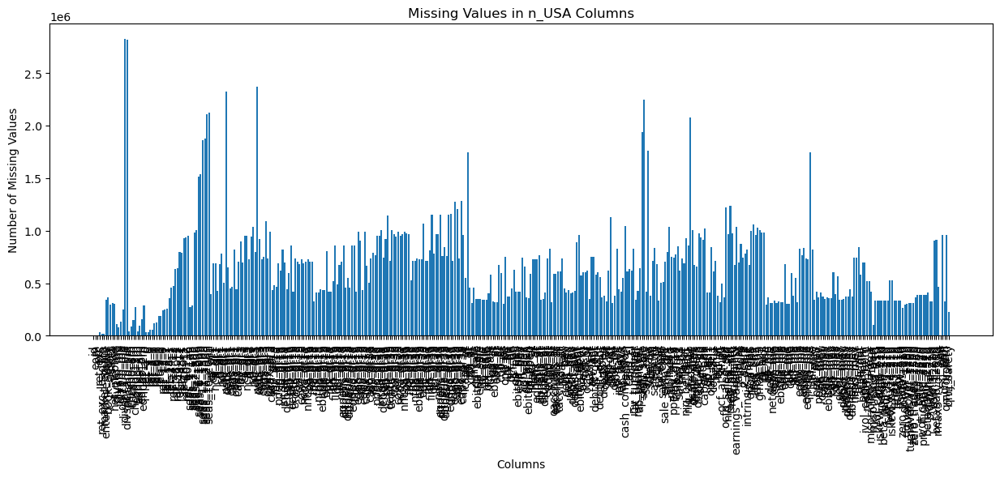

In [55]:
missing_values = n_USA.isnull().sum()

# Convert to DataFrame for better visualization
missing_values_df = missing_values.reset_index()
missing_values_df.columns = ['Column', 'Missing Values']

# Display the table
print(missing_values_df)

# Visualize the missing values
plt.figure(figsize=(15, 5))
plt.bar(missing_values_df['Column'], missing_values_df['Missing Values'])
plt.xticks(rotation=90)
plt.xlabel('Columns')
plt.ylabel('Number of Missing Values')
plt.title('Missing Values in n_USA Columns')
plt.show()

### Lag

In [31]:
def apply_lag(data, monthly_features, quarterly_features, yearly_features, m_lag=1, q_lag=4, y_lag=12):
    """
    Applies lag to the features based on their reporting frequency.
    
    Parameters:
    data (pd.DataFrame): The input DataFrame.
    monthly_features (list): List of features reported monthly.
    quarterly_features (list): List of features reported quarterly.
    yearly_features (list): List of features reported yearly.
    
    Returns:
        pd.DataFrame: The DataFrame with lag applied to the specified features.
    """
    # Apply lag for monthly features (lag of 1)
    for feature in monthly_features:
        data[feature] = data.groupby('id')[feature].shift(m_lag)
    
    # Apply lag for quarterly features (lag of 4)
    for feature in quarterly_features:
        data[feature] = data.groupby('id')[feature].shift(q_lag)
    
    # Apply lag for yearly features (lag of 12)
    for feature in yearly_features:
        data[feature] = data.groupby('id')[feature].shift(y_lag)
    
    return data

#### Standardize

In [32]:
def standardize_characteristics(data, date_col, characteristics, range_min=-0.5, range_max=0.5):
    """
    Standardizes the given characteristics period-by-period by ranking and transforming into a specified interval.
    
    Parameters:
    data (pd.DataFrame): The input DataFrame with columns 'id', date_col and characteristics.
    characteristics (list): List of characteristics to be standardized.
    range_min (float): The minimum value of the target range. Defaults to -0.5.
    range_max (float): The maximum value of the target range. Defaults to 0.5.
    
    Returns:
        pd.DataFrame: The DataFrame with standardized characteristics.
    """
    # Ensure date_col is of datetime type for proper grouping
    data[date_col] = pd.to_datetime(data[date_col])
    
    # Function to standardize a single column
    def standardize_column(col):
        ranks = rankdata(col, method='average')
        n_non_missing = len(ranks)
        standardized = (ranks - 1) / (n_non_missing - 1)  # Normalize ranks to [0, 1]
        scaled = standardized * (range_max - range_min) + range_min  # Scale to the desired range
        return scaled
    
    # Apply the standardization period-by-period for each characteristic
    for characteristic in characteristics:
        data[characteristic] = data.groupby(date_col)[characteristic].transform(standardize_column)
    
    return data

## Caculate Correlation

In [56]:
def cal_cs_stats(df, time_column, value_column, additional_percentiles=False):
    """
    Calculate cross-sectional statistics for each time period.
    
    Args:
        df (pd.DataFrame): The data frame containing the data.
        time_column (str): The name of the column representing time periods.
        value_column (str): The name of the column representing the values of X.
        additional_percentiles (list of float): Additional percentiles to calculate (optional).
    
    Returns:
        pd.DataFrame: A data frame containing the calculated statistics for each time period.
    """
    if additional_percentiles:
        additional_percentiles_list = [0.01, 0.02, 0.03, 0.04, 0.96, 0.97, 0.98, 0.99]

    # Function to calculate the required statistics for a given period
    def calc_period_stats(group, additional_percentiles=additional_percentiles):
        stats = {
            'Time': group[time_column].iloc[0],  # Time column
            'Mean': group[value_column].mean(),
            'SD': group[value_column].std(),
            'Skew': skew(group[value_column], nan_policy='omit'),
            'Kurt': kurtosis(group[value_column], nan_policy='omit'),
            'Min': group[value_column].min(),
            'Median': group[value_column].median(),
            'Max': group[value_column].max(),
            'P5': group[value_column].quantile(0.05),
            'P25': group[value_column].quantile(0.25),
            'P75': group[value_column].quantile(0.75),
            'P95': group[value_column].quantile(0.95),
            'N': group[value_column].count()
        }
        
        if additional_percentiles:
            for percentile in additional_percentiles_list:
                stats[f'P{int(percentile*100)}'] = group[value_column].quantile(percentile)
        
        return pd.Series(stats)
    
    # Group the data by the time column and apply the function
    stats_df = df.groupby(time_column).apply(calc_period_stats).reset_index(drop=True)
    
    
    return stats_df

In [18]:
def generate_report(df, time_column, value_column, additional_percentiles=False):
    stats_df = cal_cs_stats(df, time_column, value_column, additional_percentiles)

    plt.figure(figsize=(10, 5))
    plt.plot(stats_df['Time'], stats_df['Mean'], label='Mean', marker='o')
    plt.fill_between(stats_df['Time'], stats_df['P5'], stats_df['P95'], color='b', alpha=0.1, label='5th-95th Percentile')
    plt.title('Mean and 5th-95th Percentile Range over Time')
    plt.xlabel('Time')
    plt.ylabel('Value')
    plt.legend()
    plt.grid(True)
    plt.savefig('stats_plot.png')
    plt.close()

    c = canvas.Canvas(f"Cross-Sectional Statistics Report-{value_column}", pagesize=letter)
    width, height = letter

    c.setFont("Helvetica-Bold", 16)
    c.drawString(100, height - 40, f"Cross-Sectional Statistics Report-{value_column}")

    c.setFont("Helvetica", 12)
    c.drawString(100, height - 80, "CS-Summary Statistics")
    col_width = width / 12
    row_height = 20

    columns = ['Time', 'Mean', 'SD', 'Skew', 'Kurt', 'Min', 'Median', 'Max', 'P5', 'P25', 'P75', 'P95', 'N']
    for i, column in enumerate(columns):
        c.drawString(100 + i * col_width, height - 100, column)

    for j, row in stats_df.iterrows():
        for i, column in enumerate(columns):
            value = row[column]
            if isinstance(value, float):
                value = f"{value:.2f}"
            c.drawString(100 + i * col_width, height - 120 - j * row_height, str(value))

    c.drawImage('stats_plot.png', 100, height - 400, width=400, height=200)

    c.showPage()
    c.save()

    print(f"Report has been generated as Cross-Sectional Statistics Report-{value_column}")

In [60]:
cs_stat_dic = {}

for ch in n_USA.drop(columns=['id','eom', 'ret_exc', 'ret_exc_lead1m']).columns:
    cs_stat_dic[ch] = cal_cs_stats(n_USA, 'eom', ch, additional_percentiles=False) 

C:\Users\YeonChan Kang\AppData\Local\Temp\ipykernel_282216\2504332190.py:42: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  stats_df = df.groupby(time_column).apply(calc_period_stats).reset_index(drop=True)
C:\Users\YeonChan Kang\AppData\Local\Temp\ipykernel_282216\2504332190.py:42: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  stats_df = df.groupby(time_column).apply(calc_period_stats).reset_index(drop=True

In [70]:
def generate_report(stats_df, feature_name):
    plt.figure(figsize=(10, 5))
    plt.plot(stats_df['Time'], stats_df['Mean'], label='Mean', marker='o')
    plt.fill_between(stats_df['Time'], stats_df['P5'], stats_df['P95'], color='b', alpha=0.1, label='5th-95th Percentile')
    plt.title(f'Mean and 5th-95th Percentile Range over Time for {feature_name}')
    plt.xlabel('Time')
    plt.ylabel('Value')
    plt.legend()
    plt.grid(True)
    plt.show()

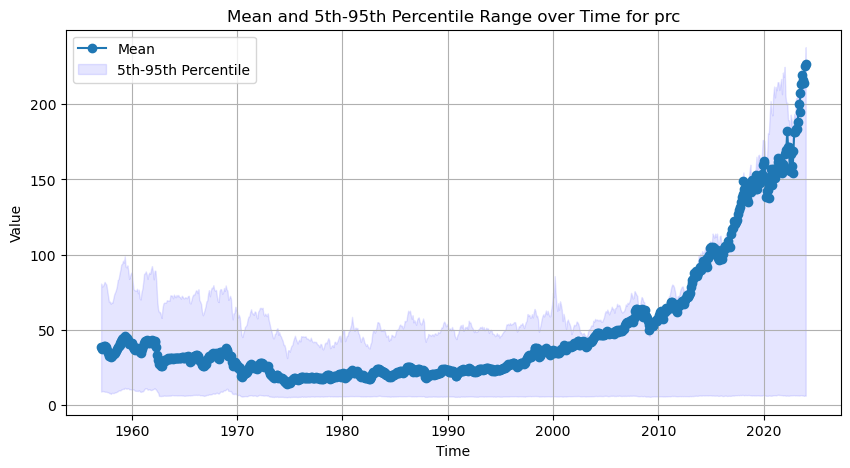

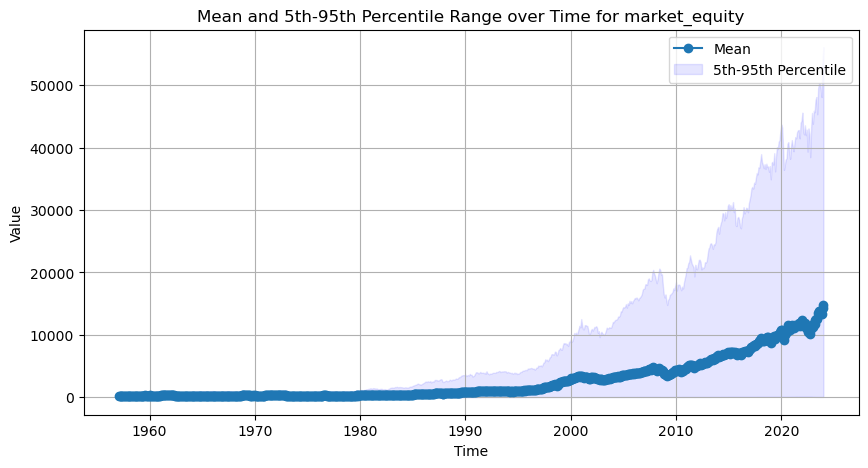

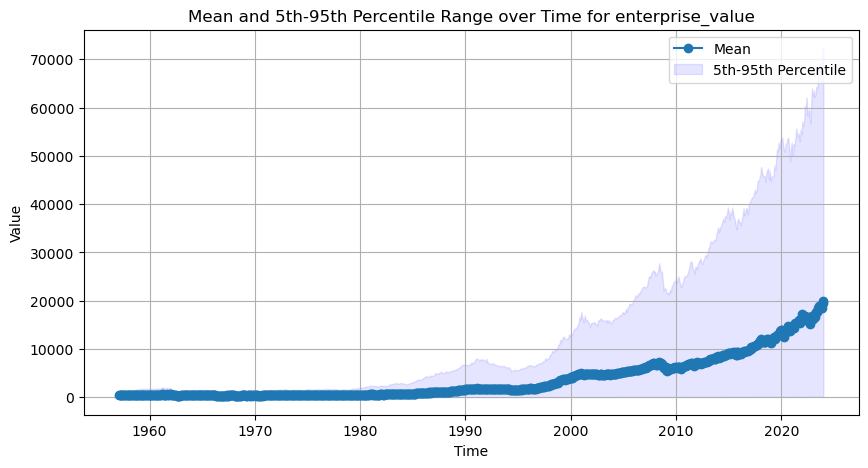

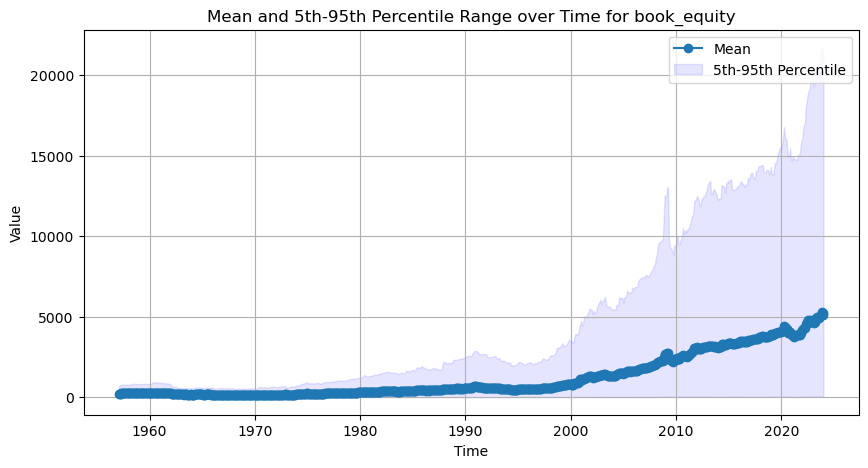

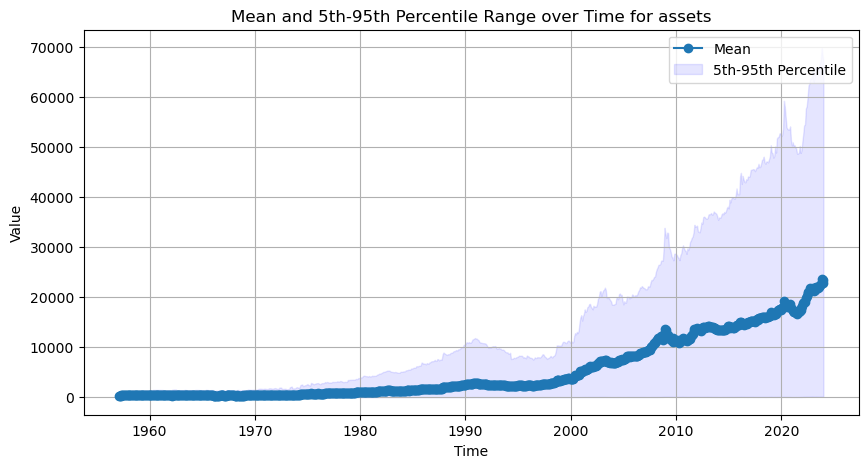

...

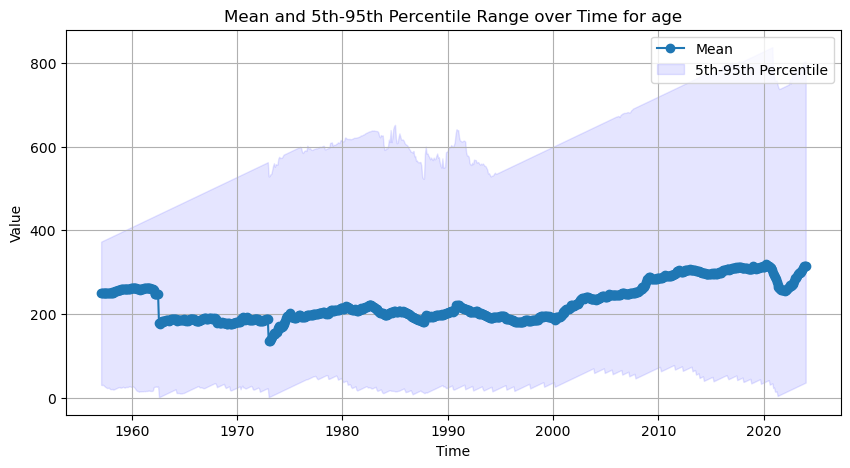

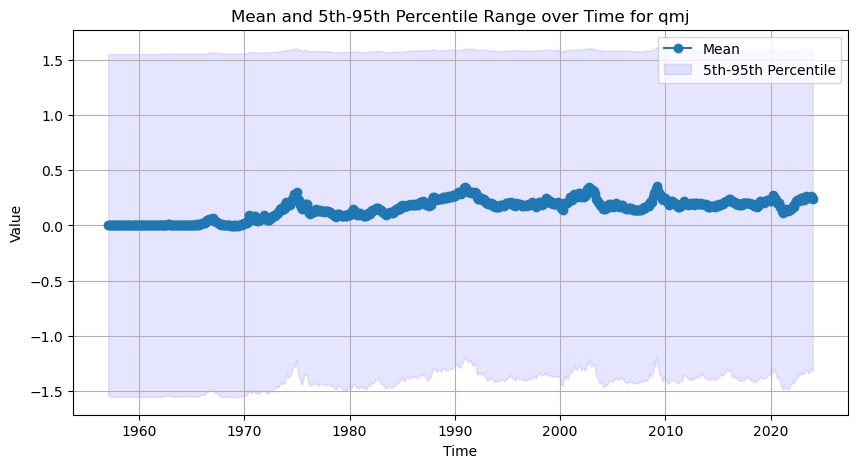

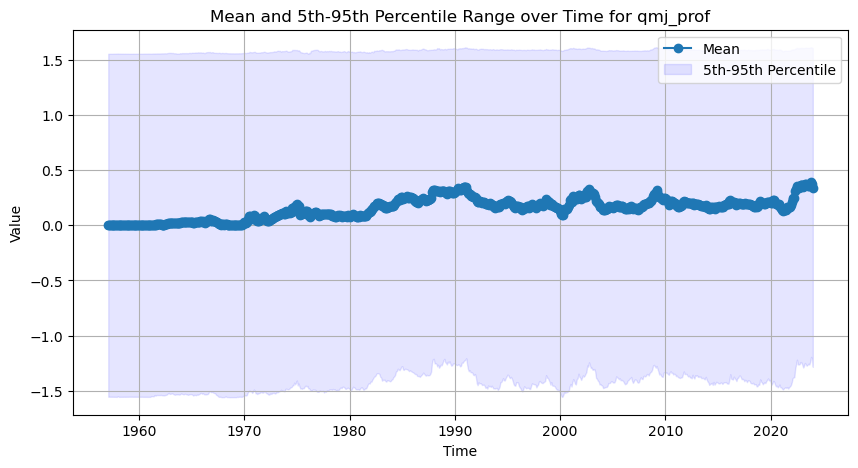

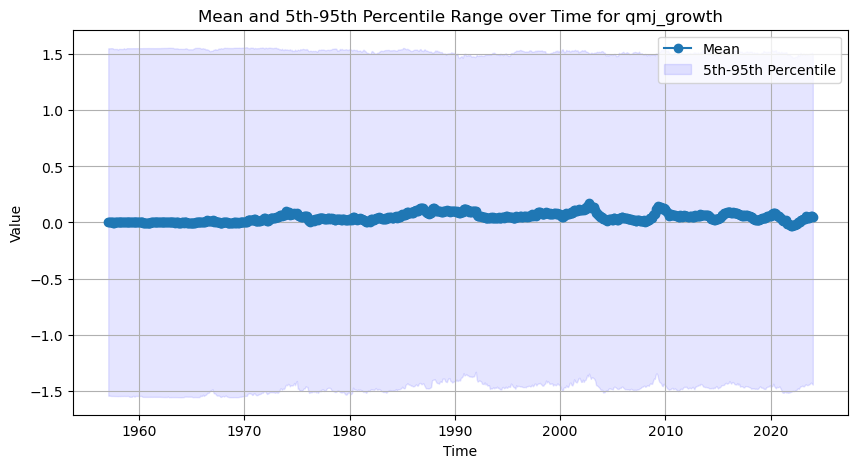

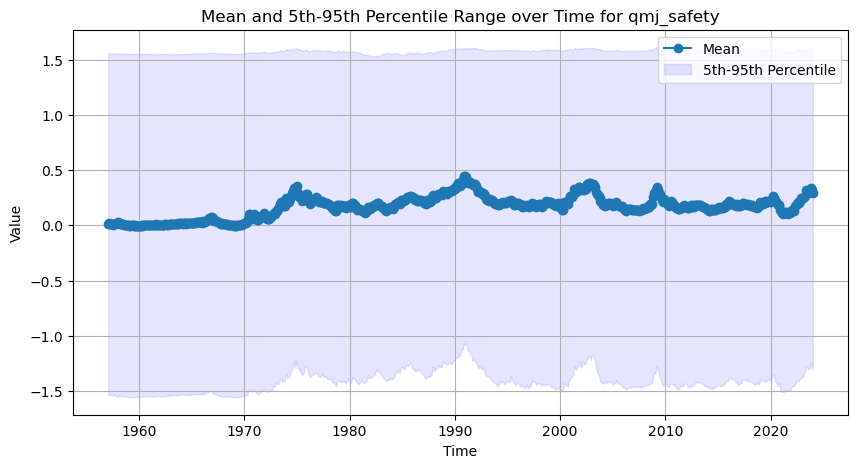

In [73]:
for feature, df in cs_stat_dic.items():
    generate_report(df, feature)

In [20]:
cs_stat_dic

{'prc':             Time        Mean           SD       Skew         Kurt     Min  \
 0     1925-12-31   63.907828    66.487864   4.997249    49.310549  0.3125   
 1     1926-01-31   61.765030    55.491750   2.551822    12.859990  0.5625   
 2     1926-02-28   57.499630    50.103010   2.013763     6.523397  0.6250   
 3     1926-03-31   52.007094    48.362521   2.503533    11.309003  0.3750   
 4     1926-04-30   53.238791    48.327696   2.584004    13.283893  0.2500   
 ...          ...         ...          ...        ...          ...     ...   
 1175  2023-11-30  152.756843  7711.038113  70.740675  5004.147571  0.0135   
 1176  2023-12-31  157.087199  7701.164155  70.400975  4956.511683  0.0107   
 1177  2024-01-31   46.427920   162.610202  22.470732   786.507307  0.0363   
 1178  2024-02-29   48.533493   171.268356  22.788546   827.467315  0.0346   
 1179  2024-03-31   49.069271   172.891099  22.458163   808.960045  0.0355   
 
       Median        Max       P5      P25        P75  

In [74]:
def cal_ts_averages(stats_df):
    """
    Calculate the time-series averages of the cross-sectional statistics.
    
    Args:
        stats_df (pd.DataFrame): A data frame containing cross-sectional statistics for each time period.
    
    Returns:
        pd.Series: A series containing the time-series averages of the cross-sectional statistics.
    """
    # Exclude the time column for averaging
    stats_to_average = stats_df.drop(columns=['Time'])
    
    # Calculate the time-series averages
    time_series_averages = stats_to_average.mean()
    
    df = pd.DataFrame(time_series_averages).T

    return df

In [86]:
ts_averages_df = pd.DataFrame()

# 각 기업 특성에 대해 반복적으로 그래프 생성 및 시계열 평균 계산
for feature, df in cs_stat_dic.items():
    ts_avg = cal_ts_averages(df)
    ts_avg.insert(0, 'Feature', feature)
    ts_averages_df = pd.concat([ts_averages_df, ts_avg])
    
ts_averages_df.reset_index(drop=True, inplace=True)

print(tabulate(ts_averages_df, headers='keys', tablefmt='grid'))

+-----+----------------------+----------------+-----------------+-------------+-------------+------------------+----------------+------------------+-----------------+------------------+----------------+-----------------+------------+
|     | Feature              |           Mean |              SD |        Skew |        Kurt |              Min |         Median |              Max |              P5 |              P25 |            P75 |             P95 |          N |
+=====+======================+================+=================+=============+=============+==================+================+==================+=================+==================+================+=================+============+
|   0 | prc                  |   49.3177      |  1217.08        |  40.7742    | 2434.44     |      5.00888     |   20.4981      |  73591.9         |     6.41126     |     11.7718      |   34.9853      |    74.0091      | 3523.28    |
+-----+----------------------+----------------+-----------------

In [90]:
ts_averages_df

,Feature,Mean,SD,Skew,Kurt,Min,Median,Max,P5,P25,P75,P95,N
0,prc,49.317698,1217.077908,40.774174,2434.443066,5.008882,20.498095,73591.902877,6.411264,11.771802,34.985316,74.009069,3523.278607
1,market_equity,2630.971278,11923.311131,16.786726,436.394690,2.052205,349.854400,339659.824127,24.074608,102.972562,1285.678187,10301.963398,3500.381841
2,enterprise_value,3706.580659,16628.779851,15.993624,379.155156,0.840266,492.899851,444414.264837,27.239137,136.006170,1861.667382,13971.898811,3097.318408
3,book_equity,1214.904542,4950.285557,14.722294,349.789705,0.449756,184.887805,110529.385565,13.015966,59.162111,634.876330,4869.023960,3068.824627
4,assets,5318.396074,34293.110017,14.571274,282.362704,0.973655,492.603220,924200.550812,25.697165,141.234272,1863.110645,15510.827567,3152.696517
...,...,...,...,...,...,...,...,...,...,...,...,...,...
399,age,227.796620,183.244552,1.173705,1.070023,3.057214,176.943408,774.500000,33.063433,89.123756,316.048197,609.664614,3523.278607
400,qmj,0.152249,0.953155,-0.138357,-1.106485,-1.727067,0.195956,1.730526,-1.420005,-0.634638,0.973515,1.579901,2326.401741
401,qmj_prof,0.152539,0.957478,-0.143840,-1.100046,-1.728899,0.194494,1.730821,-1.433334,-0.635407,0.980888,1.582234,3119.390547
402,qmj_growth,0.046798,0.954061,-0.044363,-1.132883,-1.726918,0.062199,1.728721,-1.481490,-0.755780,0.857725,1.527292,2326.492537


C:\Users\YeonChan Kang\AppData\Local\Temp\ipykernel_282216\468816785.py:3: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ts_averages_log_df[numeric_cols] = ts_averages_log_df[numeric_cols].applymap(lambda x: np.log1p(x))
C:\Users\YeonChan Kang\AppData\Local\Temp\ipykernel_282216\468816785.py:3: RuntimeWarning: invalid value encountered in log1p
  ts_averages_log_df[numeric_cols] = ts_averages_log_df[numeric_cols].applymap(lambda x: np.log1p(x))
C:\Users\YeonChan Kang\AppData\Local\Temp\ipykernel_282216\468816785.py:3: RuntimeWarning: divide by zero encountered in log1p
  ts_averages_log_df[numeric_cols] = ts_averages_log_df[numeric_cols].applymap(lambda x: np.log1p(x))


<Figure size 1500x2000 with 0 Axes>

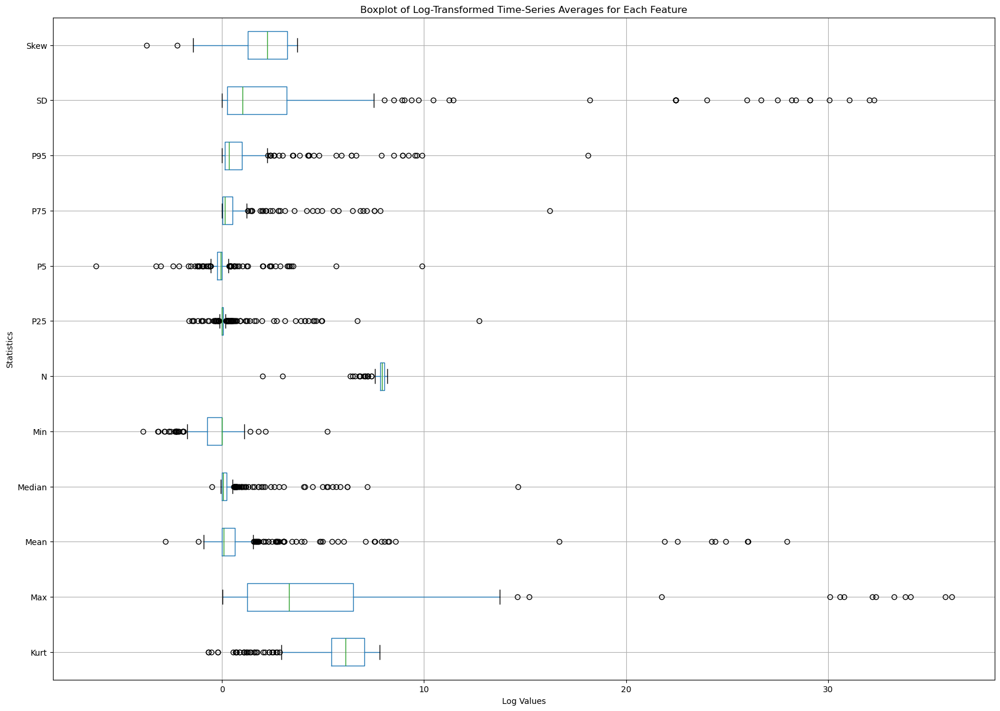

<Figure size 1500x2000 with 0 Axes>

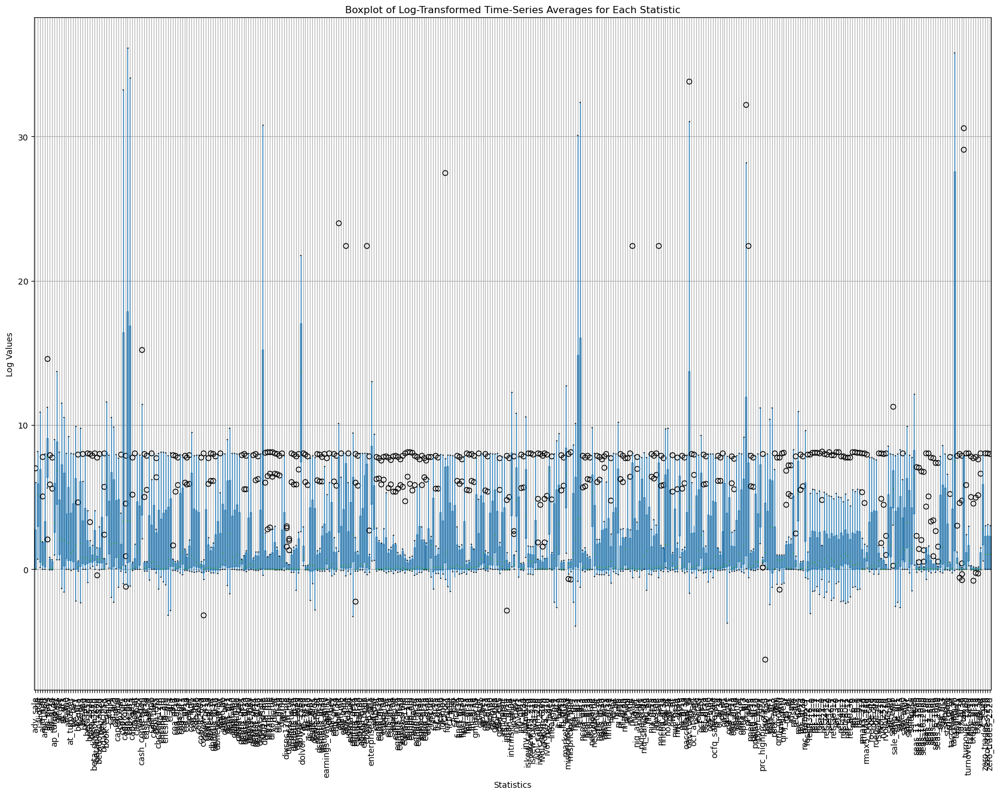

In [100]:
ts_averages_log_df = ts_averages_df.copy()
numeric_cols = ts_averages_log_df.columns.difference(['Feature'])
ts_averages_log_df[numeric_cols] = ts_averages_log_df[numeric_cols].applymap(lambda x: np.log1p(x))

# Boxplot으로 시각화 (각 feature를 y축에 배치)
plt.figure(figsize=(15, 20))
ts_averages_long_df = ts_averages_log_df.melt(id_vars=["Feature"], var_name="Statistic", value_name="Value")
ts_averages_long_df.boxplot(by="Statistic", column="Value", vert=False, figsize=(20, 15))
plt.title('Boxplot of Log-Transformed Time-Series Averages for Each Feature')
plt.suptitle('')
plt.xlabel('Log Values')
plt.ylabel('Statistics')
plt.show()

# Boxplot으로 시각화 (각 feature를 y축에 배치)
plt.figure(figsize=(15, 20))
ts_averages_long_df.boxplot(by="Feature", column="Value", vert=True, figsize=(20, 15))
plt.title('Boxplot of Log-Transformed Time-Series Averages for Each Statistic')
plt.suptitle('')
plt.xlabel('Statistics')
plt.ylabel('Log Values')
plt.xticks(rotation=90)
plt.show()

In [101]:
def cal_corr(group, var1, var2, option='all'):
    """
    Calculate the correlation between two variables for a given period.

    Args:
        group (pd.DataFrame): The data for the given period.
        var1 (str): The name of the first variable.
        var2 (str): The name of the second variable.
        option (str): The correlation type to calculate ('pearson', 'spearman', or 'all'). Defaults to 'all'.
        
    Returns:
        pd.Series: A series containing the correlation between the two variables.
    """
    if option == 'pearson':
        pearson_corr, _ = pearsonr(group[var1], group[var2])
        return pd.Series({'Pearson': pearson_corr})
    elif option == 'spearman':
        spearman_corr, _ = spearmanr(group[var1], group[var2])
        return pd.Series({'Spearman': spearman_corr})
    elif option == 'all':
        pearson_corr, _ = pearsonr(group[var1], group[var2])
        spearman_corr, _ = spearmanr(group[var1], group[var2])
        return pd.Series({'Pearson': pearson_corr, 'Spearman': spearman_corr})
    else:
        raise ValueError("Invalid option for correlation type. Choose from 'pearson', 'spearman', or all'.")

In [ ]:
USA['roa_ch5']

In [1]:
cal_corr(USA, 'roa_ch5', 'rmax1_21d')

NameError: name 'cal_corr' is not defined

In [ ]:
def cal_ts_avcorr(correlations_df):
    """
    Calculate the time-series averages of the periodic cross-sectional correlations.
    
    Args:
        correlations_df (pd.DataFrame): A data frame containing the periodic correlations.
    
    Returns:
        pd.DataFrame: A data frame containing the time-series average Pearson and Spearman correlations.
    """
    avg_corrs = correlations_df.groupby(['Var1', 'Var2'])[['Pearson', 'Spearman']].mean().reset_index()
    return avg_corrs

In [ ]:
def create_corr_mat(avg_corrs, variables):
    """
    Create a correlation matrix with Pearson correlations below the diagonal and Spearman correlations above the diagonal.
    
    Args:
        avg_corrs (pd.DataFrame): A data frame containing the average correlations.
        variables (list of str): List of column names representing the variables.
    
    Returns:
        pd.DataFrame: A correlation matrix.
    """
    matrix = pd.DataFrame(index=variables, columns=variables)

    for _, row in avg_corrs.iterrows():
        var1, var2 = row['Var1'], row['Var2']
        pearson, spearman = row['Pearson'], row['Spearman']
        matrix.at[var1, var2] = f"{spearman:.2f}"
        matrix.at[var2, var1] = f"{pearson:.2f}"
    
    np.fill_diagonal(matrix.values, np.nan)
    return matrix